# Neural Data Science Project 02

## Working with Calcium data

In the following project you will recieve a data set, along with a set of questions. Use the methods that you have learned throughout this course to explore the data and to answer the questions. You are free to use tools, resources and libraries as you see fit. Use comments and markdown cells to document your thought process and to explain your reasoning. We encourage you to compare different algorithms or to implement state of the art solutions. The notebook should be self contained, although you may offload some functions to a `utils.py`. The notebook should be concluded with a final summary / conclusions section.

## Context
![image.png](output/images/vcd-task.png)

The data set that goes along with this notebook was recorded using in vivo 2-photon calcium imaging to measure the activity of genetically identified neurons in the visual cortex of mice performing a go/no-go visual change detection task. The data recordings stem from primary visual cortex and a GCaMP6f indicator was used. The data was recorded as follows.

![image-3.png](output/images/vcd-graph.png)

The data consists of:
- the preprocessed activity traces (df/f)
- the stimulus metadata
- the stimulus frames
- the ROI masks for each cell
- a maximum activity projection of the recorded area
- running speed
- table of stimulus epochs

You will only work with a locally sparse noise stimulus.

Since the experiments were performed in sequence the calcium recordings that you receive also contain some other stimulus modalities (see `data["stim_epoch_table"]`). You can ignore these sections of the time-series data during analysis. Not all the data provided has to be used, however it can be incorporated into your analysis.

In [24]:
# import packages here

import numpy as np
import pandas as pd
import jupyter_black

jupyter_black.load()

In [25]:
# load data
def load_data(path="."):
    def array2df(d, key, cols):
        d[key] = pd.DataFrame(d[key], columns=cols)

    data = np.load(path + "/dff_data_rf.npz", allow_pickle=True)
    data = dict(data)
    array2df(data, "stim_table", ["frame", "start", "end"])
    array2df(data, "stim_epoch_table", ["start", "end", "stimulus"])

    return data


def print_info(data):
    data_iter = ((k, type(v), v.shape) for k, v in data.items())
    l = [f"[{k}] - {t}, - {s}" for k, t, s in data_iter]
    print("\n".join(l) + "\n")


data = load_data()

print("Overview of the data")
print_info(data)

Overview of the data
[t] - <class 'numpy.ndarray'>, - (105968,)
[dff] - <class 'numpy.ndarray'>, - (189, 105968)
[stim_table] - <class 'pandas.core.frame.DataFrame'>, - (8880, 3)
[stim] - <class 'numpy.ndarray'>, - (9000, 16, 28)
[roi_masks] - <class 'numpy.ndarray'>, - (189, 512, 512)
[max_projection] - <class 'numpy.ndarray'>, - (512, 512)
[running_speed] - <class 'numpy.ndarray'>, - (2, 105968)
[stim_epoch_table] - <class 'pandas.core.frame.DataFrame'>, - (7, 3)



# Duration of the experiment

The $t$ vector gives the time in seconds for each recorded point of the experiment. From this we can deduce that the current sampling rate is approximately `30.14` Hz and the number of frames we have gathered data for is `105968`. The estimated sampling rate from these recorded times is approximately.

In [64]:
print(data["t"])
# Deduced Sampling rate.
sampling_intervals = np.diff(data["t"])
sampling_rate = 1 / np.mean(sampling_intervals)
print(f"Estimated sampling rate: {sampling_rate:.2f} Hz")

[   9.33015    9.36332    9.39649 ... 3524.51876 3524.55193 3524.5851 ]
Estimated sampling rate: 30.14 Hz


## Preprocessed Activity Traces

We are give the preprocessed activity rates as `df/f` for each of the $189$ nuerons give us $105968$ mearued activity from the calcium imaging recordings.

(189, 105968)


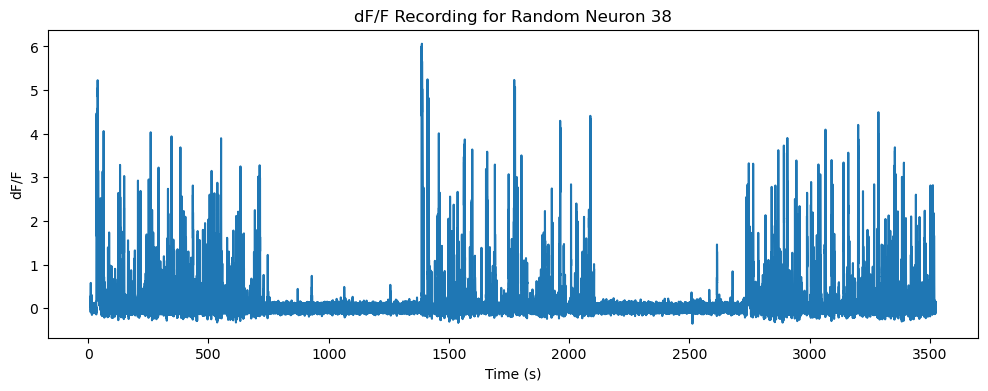

In [69]:
import numpy as np

import matplotlib.pyplot as plt

print(data["dff"].shape)

# Select a random neuron index
num_neurons = data["dff"].shape[0]
random_neuron_idx = np.random.randint(num_neurons)

# Plot the dff recording for the selected neuron
plt.figure(figsize=(12, 4))
plt.plot(data["t"], data["dff"][random_neuron_idx])
plt.title(f"dF/F Recording for Random Neuron {random_neuron_idx}")
plt.xlabel("Time (s)")
plt.ylabel("dF/F")
plt.show()

## Stimulus Meta-Data



# Stimulus

The stimulus consists of 9000 unique frames each of size $16 \times 28$ of gray scale values. The stimulus is defined as `locally_sparse_stimlus` and is active for certain subset of of the trial.

Shape of stimulus data (9000, 16, 28)


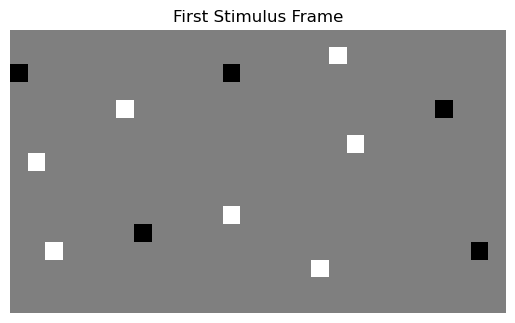

Number of unique stimulus frames: 9000


In [ ]:
import matplotlib.pyplot as plt

print(f"Shape of stimulus data {data['stim'].shape}")

plt.imshow(data["stim"][0], cmap="gray")
plt.title("First Stimulus Frame")
plt.axis("off")
plt.show()
# Check uniqueness of stimulus frames
num_unique_frames = np.unique(
    data["stim"].reshape(data["stim"].shape[0], -1), axis=0
).shape[0]
print(f"Number of unique stimulus frames: {num_unique_frames}")
assert num_unique_frames == data["stim"].shape[0], "Not all stimulus frames are unique!"
# Confirm that each stimulus frame is unique

In [ ]:
import os
import matplotlib.pyplot as plt
save_all_images_to_directory = False

if save_all_images_to_directory:
    stim_frames = data["stim"]
    n_frames = stim_frames.shape[0]
    frames_per_page = 25
    n_pages = int(np.ceil(n_frames / frames_per_page))

    # Ensure output directory exists
    stim_grid_dir = os.path.join(output_dir, "stimulus_grids")
    os.makedirs(stim_grid_dir, exist_ok=True)

    for page in range(n_pages):
        fig, axes = plt.subplots(5, 5, figsize=(10, 10))
        axes = axes.flatten()
        start_idx = page * frames_per_page
        end_idx = min(start_idx + frames_per_page, n_frames)
        for i, ax in enumerate(axes):
            frame_idx = start_idx + i
            if frame_idx < end_idx:
                ax.imshow(stim_frames[frame_idx], cmap="gray")
                ax.set_title(f"Frame {frame_idx}")
            ax.axis("off")
        plt.tight_layout()
        filename = os.path.join(stim_grid_dir, f"stimulus_grid_page_{page+1}.png")
        plt.savefig(filename)
        plt.close(fig)
else:
    print(
        "Skipping saving all images to directory. Set `save_all_images_to_directory` to True to enable saving."
    )

Skipping saving all images to directory. Set `save_all_images_to_directory` to True to enable saving.


### What are locally sparse noise stimulus ?

**Locally Sparse**: In each frame, most of the screen is a neutral grey. Only a few, small, randomly 
chosen locations ("local") have either a black or a white square. The rest of the screen is blank ("sparse").

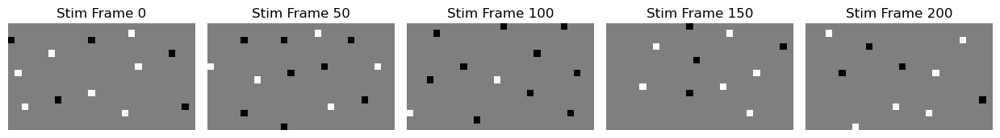

In [43]:
import utils as U
import importlib

importlib.reload(U)  # Use this if you update your utils.py file

# # First, let's look at a few static frames again for context
U.plot_stim_frames(data, indices_to_display=[0, 50, 100, 150, 200])

## What is th frequency with which a particular stimulus frame is held ?

The `data['stim_table']` contains 8880 rows indicating the stimulus frame which is shown and duration  in both sample indices and the start and end time in seconds. Each of the 8880 rows contain one frame after the other all the way from $[0 -  8879]$ inclusive

In [90]:
print(f"Stim Table shape: {data['stim_table'].shape}")
data["stim_table"]

Stim Table shape: (8880, 5)


,frame,start,end,start_s,end_s
0,0,737,744,0.737,0.744
1,1,745,752,0.745,0.752
2,2,752,759,0.752,0.759
3,3,760,767,0.760,0.767
4,4,767,774,0.767,0.774
...,...,...,...,...,...
8875,8875,105705,105712,105.705,105.712
8876,8876,105712,105719,105.712,105.719
8877,8877,105720,105727,105.720,105.727
8878,8878,105727,105734,105.727,105.734


In [112]:
# Check that the frame in tim table is not repeated
# Check that the frame in stim_table is not repeated
num_unique_frames_in_table = data["stim_table"]["frame"].nunique()
num_total_frames_in_table = len(data["stim_table"]["frame"])
print(f"Unique frames in stim_table: {num_unique_frames_in_table}")
print(f"Total frames in stim_table: {num_total_frames_in_table}")
if num_unique_frames_in_table == num_total_frames_in_table:
    print("No repeated frames in stim_table.")
else:
    print("There are repeated frames in stim_table.")

Unique frames in stim_table: 8880
Total frames in stim_table: 8880
No repeated frames in stim_table.


In [ ]:
# Che3ck that data["stim"] each row contains distinct unique frames.
# Check that each row in data["stim"] is unique
stim_reshaped = data["stim"].reshape(data["stim"].shape[0], -1)
num_unique_stim_frames = np.unique(stim_reshaped, axis=0).shape[0]
print(f"Number of unique frames in data['stim']: {num_unique_stim_frames}")
assert (
    num_unique_stim_frames == data["stim"].shape[0]
), "Not all frames in data['stim'] are unique!"

Number of unique frames in data['stim']: 9000


In [ ]:
# The total number of samples by looking and the number of sample in each row  by takding difference of start and end sample points and adding them up gives
total_samples = np.sum(data["stim_table"]["end"] - data["stim_table"]["start"])
print(f"Total number of samples in the stimulus table: {total_samples}")

Total number of samples in the stimulus table: 62521


### Are all the frames in the stim table one ofter the other, that is incrementing by one on each row or not ?


In [ ]:

# Check if 'frame' column increments by one for each row
frame_diffs = data["stim_table"]["frame"].diff().fillna(1)
all_consecutive = np.all(frame_diffs == 1)
print(f"Are all frames consecutive? {all_consecutive}")

# If not, show indices where it's not consecutive
if not all_consecutive:
    non_consecutive_indices = np.where(frame_diffs != 1)[0]
    print(f"Indices where frames are not consecutive: {non_consecutive_indices}")
    print(
        f"Frame values at those indices: {data['stim_table']['frame'].iloc[non_consecutive_indices].values}"
    )

Are all frames consecutive? True


 #### Are there any un accounted for gaps between start and end in the data['stim_table'], that is does the, start of one row proceed right after the end of the previous row?

In [111]:
import numpy as np

stim_table = data["stim_table"]
gaps = stim_table["start"].values[1:] - stim_table["end"].values[:-1]
print(f"Number of gaps found: {np.sum(gaps > 0)}")
if np.any(gaps > 0):
    print("There are gaps between start and end in the data['stim_table'].")
    print(f"Number of gaps found: {np.sum(gaps > 0)}")
    print(f"Indices of gaps found: {np.where(gaps > 0)[0]}")
    # what is the size of the gaps?
    gap_sizes = gaps[gaps > 0]
    print(f"Sizes of gaps found: {gap_sizes}")
    print(f"Start of gaps: {stim_table['start'].values[1:][gaps > 0]}")
    print(f"End of gaps: {stim_table['end'].values[:-1][gaps > 0]}")
    # what is the maximum gap size ?
    max_gap_size = np.max(gap_sizes)
    print(f"Maximum gap size: {max_gap_size}")
    # what is the minimum gap size ?
    min_gap_size = np.min(gap_sizes)
    print(f"Minimum gap size: {min_gap_size}")
    # what is the average gap size ?
    avg_gap_size = np.mean(gap_sizes)
    print(f"Average gap size: {avg_gap_size}")
    # what is the median gap size ?
    median_gap_size = np.median(gap_sizes)
    print(f"Median gap size: {median_gap_size}")
else:
    print("No gaps found between start and end in the data['stim_table'].")

Number of gaps found: 4462
There are gaps between start and end in the data['stim_table'].
Number of gaps found: 4462
Indices of gaps found: [   0    2    4 ... 8874 8876 8878]
Sizes of gaps found: [1 1 1 ... 1 1 1]
Start of gaps: [   745    760    775 ... 105705 105720 105735]
End of gaps: [   744    759    774 ... 105704 105719 105734]
Maximum gap size: 19015
Minimum gap size: 1
Average gap size: 9.521290900941281
Median gap size: 1.0


In [ ]:
# Calculate the duration each stimulus frame is held
frame_durations = data["stim_table"]["end_s"] - data["stim_table"]["start_s"]

# Check if all durations are the same (should be close to 1/sampling_rate)
unique_durations = np.unique(frame_durations.round(6))
print(f"Unique frame durations (s): {unique_durations}")

# Show summary statistics
print(f"Mean frame duration: {frame_durations.mean():.6f} s")
print(f"Std frame duration: {frame_durations.std():.6f} s")

# Is it one frame per duration?
print(f"Number of stimulus frames: {data['stim_table'].shape[0]}")
print(f"Number of entries in stim_table: {len(data['stim_table'])}")

Unique frame durations (s): [0.007 0.008 0.009]
Mean frame duration: 0.007041 s
Std frame duration: 0.000199 s
Number of stimulus frames: 8880
Number of entries in stim_table_filtered_df: 8880


### Stimulus Epoch Table

The stimulus epoch table consists tells us the durations where locally_sparse_noise is active.

In [40]:
data["stim_epoch_table"]

,stimulus,start_time,end_time
0,locally_sparse_noise,737,22461
1,spontaneous,22611,31520
2,natural_movie_one,31521,40571
3,locally_sparse_noise,41476,63199
4,natural_movie_two,64105,73156
5,spontaneous,73306,82207
6,locally_sparse_noise,82208,105742


In [107]:
# We look at the start and end time when the stimulus locally sparse noise is active and sum them up to compute the total number of steps for which the locally_sparse_noise stimulus is active.
stim_epoch_table = data["stim_epoch_table"]
# that is we make sure stimuls column == "locally_sparse_noise"
locally_sparse_noise_epochs = stim_epoch_table[
    stim_epoch_table["stimulus"] == "locally_sparse_noise"
]
print(locally_sparse_noise_epochs)
# for each row, we compute the duration of the stimulus
locally_sparse_noise_epochs.loc[:, "duration"] = (
    locally_sparse_noise_epochs["end_time"] - locally_sparse_noise_epochs["start_time"]
)
print(locally_sparse_noise_epochs)
# and sum them up
total_duration = locally_sparse_noise_epochs["duration"].sum()
print(f"Total duration of locally_sparse_noise stimulus: {total_duration} samples")

               stimulus start_time end_time
0  locally_sparse_noise        737    22461
3  locally_sparse_noise      41476    63199
6  locally_sparse_noise      82208   105742
               stimulus start_time end_time duration
0  locally_sparse_noise        737    22461    21724
3  locally_sparse_noise      41476    63199    21723
6  locally_sparse_noise      82208   105742    23534
Total duration of locally_sparse_noise stimulus: 66981 samples


/var/folders/_q/9l1zk1853mv45phss2fsffd00000gn/T/ipykernel_1412/4133913974.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  locally_sparse_noise_epochs.loc[:, "duration"] = (


In [108]:
data.keys()

dict_keys(['t', 'dff', 'stim_table', 'stim', 'roi_masks', 'max_projection', 'running_speed', 'stim_epoch_table', 'preprocessing_done'])

# Mouse running Speed  Data

The element `data['running_speed']` contains information regarding the running speed of the mouse, it has 
the shape $2 \times 105968$ where `data['running_speed'][1]` consists of the running speed at points of time. The mouse running 
speed/behavioral data is not used in our current analysis.

In [55]:
data["running_speed"][1].shape

(105968,)

Performing initial data preprocessing...
Preprocessing complete.
Filtering time-series data for 'locally_sparse_noise' epochs...
Total epochs available: 7
Epochs columns: ['stimulus', 'start_time', 'end_time']
Looking for epochs with stimulus name: locally_sparse_noise
Epochs with stimulus 'locally_sparse_noise': 3  
Time-series filtering complete.
Filtered dff shape: (189, 1760)
Filtered t shape: (1760,)
Filtering stimulus data to match the selected time epochs...
Stimulus filtering complete.
Filtered stim_table_df shape: (7739, 5)
Filtered stim shape: (7739, 16, 28)


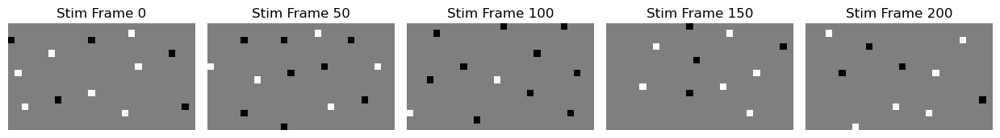

In [31]:
from IPython.display import HTML
import utils as U
import importlib

importlib.reload(U)
# 0. Load the raw data
if not data:
    data = load_data()

# 1. Perform initial preprocessing (column renaming, time conversion)
data = U.preprocess_data(data)

# 2. Filter the time-series data (dff, t, etc.) for the correct epochs
t_filtered, dff_filtered, running_speed_filtered = U.filter_timeseries_by_epoch(
    data, stimulus_name="locally_sparse_noise"
)

# 3. Filter the stimulus frames based on the new filtered time vector
stim_filtered, stim_table_filtered_df = U.filter_stimulus_data(data, t_filtered)

# # First, let's look at a few static frames again for context
U.plot_stim_frames(data, indices_to_display=[0, 50, 100, 150, 200])

# # Now, visualize the first 1000 frames of the filtered stimulus as a movie
# # (Using a slice like [:1000] makes the animation render faster)
HTML(U.visualize_stimulus_movie(stim_filtered[:1000]).to_jshtml())

# What is the maximal activity projection?


The "Maximum Activity Projection" is a single summary image created by collapsing that entire movie into one picture.

For every single pixel in the 512x512 grid, the computer looks through all the frames of the movie and finds the highest (maximum) brightness value that pixel ever reached during the entire recording. It then creates a new, single image where each pixel's value is set to that maximum brightness.

The resulting image gives you a static, anatomical-like view of the recording area.

* **Bright Spots**: The brightest spots in the projection are typically the locations of neurons (or parts of neurons) that were highly active (i.e., had a large calcium influx, causing high fluorescence) at some point during the experiment.

* **Background**: The dimmer areas are parts of the tissue that were never highly fluorescent.

Why is it useful ?

It serves as an excellent anatomical reference map. It's the perfect background image to overlay  other spatial data on, such as:

The ROI masks to see the exact outlines of the detected neurons.

The receptive field centers, show where the "seeing" parts of the neurons are located relative to their physical bodies.

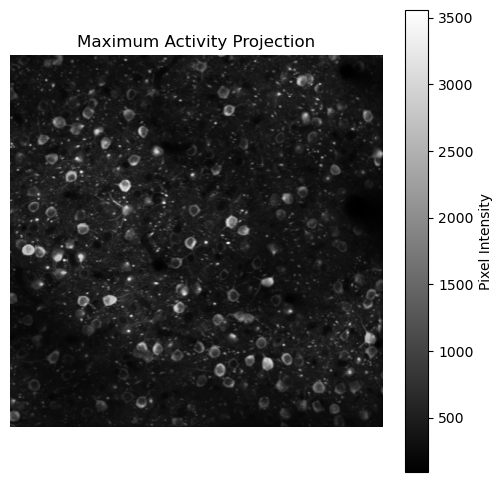

In [28]:
import importlib
import logging
import utils as U

importlib.reload(U)
logging.basicConfig(
    level=logging.INFO, format="%(asctime)s - %(levelname)s - %(message)s"
)
# 2. Call the visualization functions
logging.info("\n--- Running Visualization Examples ---")
importlib.reload(U)

# Example 1: Plot max projection and show it on screen
U.plot_max_projection(data)

# ROI Masks
## What are ROI masks ?


ROI masks indicate the position and rough planar geometry of the nueron. Only ROI centers not their morphology is used in present analysis.

In [29]:
roi_masks = data["roi_masks"]
roi_masks.shape

(189, 512, 512)

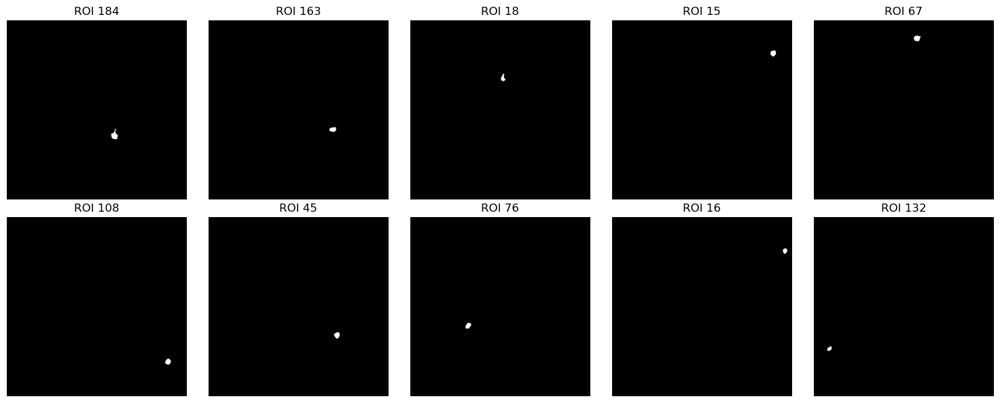

In [34]:
# Plot 10 random roi masks.
np.random.seed(42)
random_indices = np.random.choice(roi_masks.shape[0], size=10, replace=False)
roi_masks_to_plot = roi_masks[random_indices]

# plot
import matplotlib.pyplot as plt

fig, axes = plt.subplots(2, 5, figsize=(15, 6))
axes = axes.flatten()
for i, ax in enumerate(axes):
    ax.imshow(roi_masks_to_plot[i], cmap="gray")
    ax.set_title(f"ROI {random_indices[i]}")
    ax.axis("off")
plt.tight_layout()
plt.show()

Calculating centroids of ROI masks...
ROI centroid calculation complete.
Visualizing all ROI mask outlines and indices...


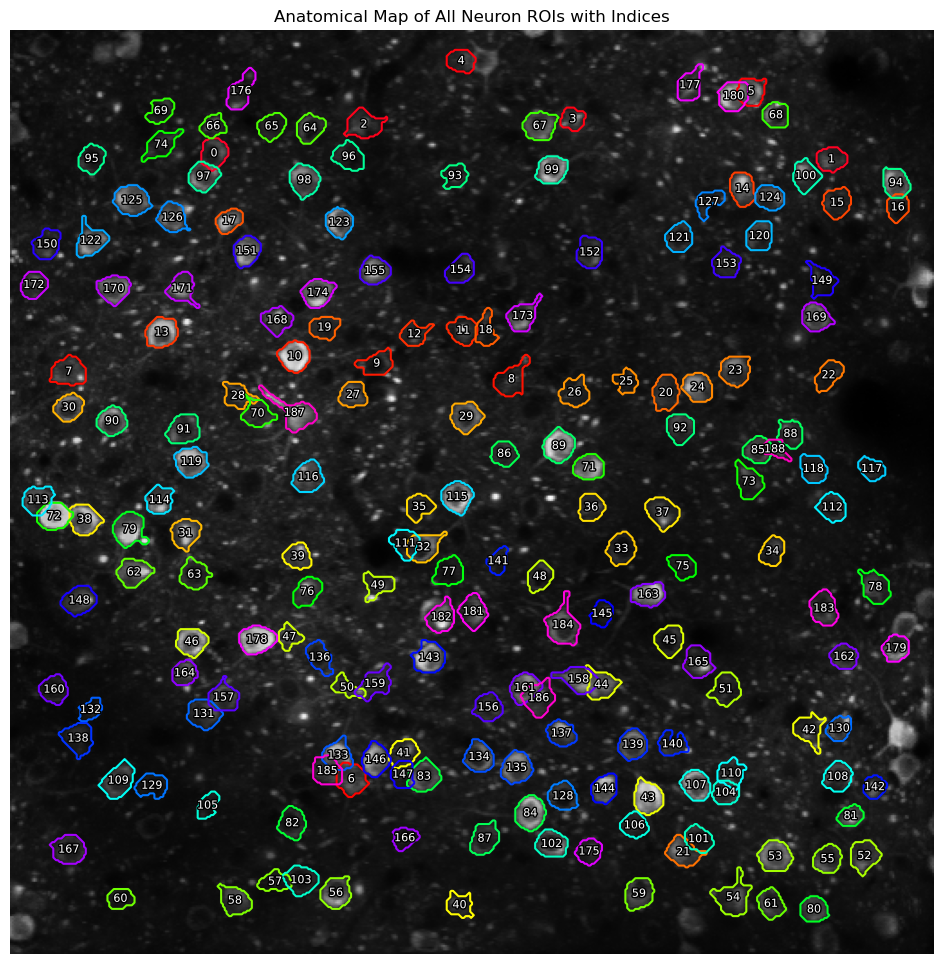

In [33]:
# --- Phase 1, Task 1.2 (continued): Visualizing Anatomical Layout ---
# Before we calculate receptive fields, let's visualize the physical
# locations of the neurons we are analyzing.

import importlib
import utils as U

importlib.reload(U)  # Reload utils to make sure we have the new functions

# --- Step 1: Get the necessary data ---
# The ROI masks contain the shape and location of each neuron.
# The max activity projection provides a good background image.
roi_masks = data["roi_masks"]
max_projection_image = data["max_projection"]

# Calculate physical centroids of neurons
roi_centroids = U.calculate_roi_centroids(roi_masks)

# --- Step 2: Plot the ROI masks on the background image ---
# This function will draw an outline for each of the 189 neurons.
U.plot_roi_masks_on_image(
    roi_masks=roi_masks,
    roi_centroids=roi_centroids,
    background_image=max_projection_image,
)

# Save Processed Dataset

In [ ]:
# Add this cell to the end of your 00-background.ipynb notebook

# --- Persist the preprocessed data to a file ---
# This saves the key filtered variables so they can be loaded by the next notebook
# without having to re-run all the preprocessing steps.

import os

# Define the output directory and ensure it exists
namespace = "submis"
output_dir = f"./data/{namespace}/background/"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)


from datetime import datetime

run_date_prefix_current_time = datetime.now().strftime("%Y_%m_%d_%H_%M_%S")
print(f"Saving inferred spikes data to file: {run_date_prefix_current_time}")

output_filename = os.path.join(
    output_dir,
    f"cleaned_{run_date_prefix_current_time}.npz",
)

# We use np.savez_compressed to save multiple arrays into a single file.
# It's efficient and keeps the data organized.
# Note: For the pandas DataFrame, we save its values and columns separately
# so we can perfectly reconstruct it upon loading.
to_save = {
    "t_filtered": t_filtered,
    "dff_filtered": dff_filtered,
    "running_speed_filtered": running_speed_filtered,
    "stim_filtered": stim_filtered,
    "stim_table_filtered": stim_table_filtered_df.values,
    "stim_table_columns": stim_table_filtered_df.columns,
}

np.savez_compressed(output_filename, **to_save)

print(f"Successfully saved preprocessed data to: {output_filename}")

Saving inferred spikes data to file: 2025_07_16_17_35_52
Successfully saved preprocessed data to: ./data/aakarsh/background/cleaned_2025_07_16_17_35_52.npz


## Tuning Function Fitting using ML - LNP

In [71]:

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import utils as U 
import importlib
import os
import glob

importlib.reload(U) 

use_cached_data = True

if use_cached_data: 
    try:
        namespace = "aakarsh" 
        background_dir = f'data/{namespace}/background/'
        list_of_background_files = glob.glob(os.path.join(background_dir, '*.npz'))
        if not list_of_background_files:
            raise FileNotFoundError(f"No background data files found in '{background_dir}'")
        
        latest_background_file = max(list_of_background_files, key=os.path.getctime)
        print(f"Loading latest background data from: {latest_background_file}")
        
        stim_data = np.load(latest_background_file, allow_pickle=True)
        stim_filtered = stim_data['stim_filtered']
        stim_table_filtered_df = pd.DataFrame(stim_data['stim_table_filtered'], columns=stim_data['stim_table_columns'])
        
        spike_inference_dir = f'data/{namespace}/preprocessed/'
        list_of_spike_files = glob.glob(os.path.join(spike_inference_dir, '*.npz'))
        if not list_of_spike_files:
            raise FileNotFoundError(f"No spike inference files found in '{spike_inference_dir}'")
        
        latest_spike_file = max(list_of_spike_files, key=os.path.getctime)
        print(f"Loading latest spike inference data from: {latest_spike_file}")
        
        spike_data = np.load(latest_spike_file, allow_pickle=True)
        print(spike_data.keys())

        inferred_spikes = spike_data['spike_counts']
        time_vector = spike_data['time_vector']
        sampling_rate = spike_data['sampling_frequency']
    
        data  = U.load_data()# Load the latest spike inference data
        data  = U.preprocess_data(data)  # Preprocess the data 

    except FileNotFoundError as e:
        print(f"ERROR: Could not find a necessary input file: {e}")
        print("Please ensure you have run the previous notebooks (00 and 02) and saved their outputs correctly.")
        raise

Loading latest background data from: data/aakarsh/background/cleaned_2025_07_16_17_35_52.npz
Loading latest spike inference data from: data/aakarsh/preprocessed/oasis_preprocessed_recordings_2025_07_18_10_16_01.npz
KeysView(NpzFile 'data/aakarsh/preprocessed/oasis_preprocessed_recordings_2025_07_18_10_16_01.npz' with keys: processed_neuron_signal, spike_counts, thresholds, sampling_frequency, time_vector)
Performing initial data preprocessing...
Preprocessing complete.


In [72]:
import utils as U
import importlib
importlib.reload(U)  # Reload utils to ensure you're using the latest version of your functions

active_stim_per_timestep = U.get_active_stimulus_per_timestep(data['stim_table'], total_timesteps=len(data['t']))
assert active_stim_per_timestep[105735] == 8879
assert active_stim_per_timestep[105735] == 8879, "The active stimulus at timestep 105735 does not match the expected value."
assert active_stim_per_timestep[737] == 0
assert active_stim_per_timestep[744] == -1,  "The active stimulus at timestep 737 does not match the expected value."
assert active_stim_per_timestep[745] == 1,  "The active stimulus at timestep 737 does not match the expected value."

Mapping active stimulus frame to each timestep...
Mapping complete.


In [74]:
# How do i use the active_stim_per_timestap to bin  the inferred spike counts ?
assert len(active_stim_per_timestep) == len(data['t']), "The length of active_stim_per_timestep does not match the length of the time vector."
for inferred_spikes in spike_data['spike_counts']:
    assert len(inferred_spikes) == len(data['t']), "The length of inferred_spikes does not match the length of the time vector."

In [95]:
importlib.reload(U)  # Reload utils to ensure you're using the latest version of your functions

# Prepare the stimulus matrix from the presented frame IDs
# Reload utils to ensure you're using the latest version of your functions

inferred_spikes = spike_data['spike_counts']
binned_spikes, presented_frame_ids =  np.array(inferred_spikes, dtype=np.float64), active_stim_per_timestep # stimulus data is already binned.

# Filter presented frame_ids and binned spikes by removing indexes where presented_Frame_ids is -1
binned_spikes = binned_spikes[:, presented_frame_ids != -1]
presented_frame_ids = presented_frame_ids[presented_frame_ids != -1]
print(f"binned_spikes.shape: {binned_spikes.shape}, presented_frame_ids.shape: {presented_frame_ids.shape}")
assert np.sum(presented_frame_ids[presented_frame_ids == -1]) == 0, "There are still -1 values in presented_frame_ids. Please check the filtering step."

flattened_stim, stim_h, stim_w = \
    U.prepare_stimulus_matrix_from_ids(presented_frame_ids, full_stim_movie=data['stim'])
print(f"Flattened stimulus shape: {flattened_stim.shape}, Stimulus height: {stim_h}, Stimulus width: {stim_w}")

binned_spikes.shape: (189, 62521), presented_frame_ids.shape: (62521,)
Preparing stimulus matrix from frame IDs...
Stimulus matrix preparation complete. Shape: (448, 62521)
Flattened stimulus shape: (448, 62521), Stimulus height: 16, Stimulus width: 28


In [96]:
# Convert the stimulus to binary matrices for 'ON' and 'OFF' stimuli, these are easier to train and give better receptive field estimates.

# Create a copy of the original flattened stimulus matrix
flattened_on_stimuli = flattened_stim.copy()
flattened_off_stimuli = flattened_stim.copy()

# For the 'ON' matrix, set all 'OFF' pixels (<= 127) to zero
flattened_on_stimuli[flattened_on_stimuli <= 127] = 0
flattened_on_stimuli[flattened_on_stimuli > 127] = 1

# For the 'OFF' matrix, set all 'ON' pixels (> 127) to zero
flattened_off_stimuli[flattened_off_stimuli < 127] = 1
flattened_off_stimuli[flattened_off_stimuli >= 127] = 0

# --- Verification ---
print(f"Flattened Stimulus Shape: {flattened_stim.shape}")
print(f"Flattened On Stimuli Shape: {flattened_on_stimuli.shape}")
print(f"Flattened Off Stimuli Shape: {flattened_off_stimuli.shape}")

# These assertions will now pass because the shape is preserved
assert flattened_on_stimuli.shape == flattened_stim.shape, "The shape of flattened_on_stimuli does not match the shape of flattened_stim."
assert flattened_off_stimuli.shape == flattened_stim.shape, "The shape of flattened_off_stimuli does not match the shape of flattened_stim."

print("\nAssertions passed! The shapes are now correct.")

Flattened Stimulus Shape: (448, 62521)
Flattened On Stimuli Shape: (448, 62521)
Flattened Off Stimuli Shape: (448, 62521)

Assertions passed! The shapes are now correct.


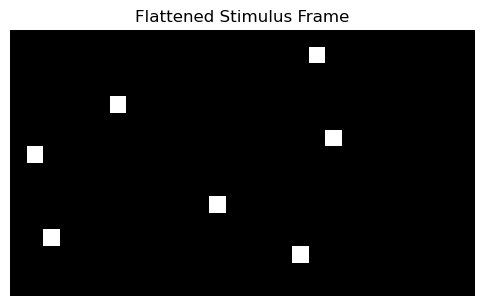

In [89]:
# Plot a single flattened stimulus frame
import matplotlib.pyplot as plt
plt.figure(figsize=(6, 6))
plt.imshow(flattened_on_stimuli[:,0].reshape(stim_h, stim_w), cmap='gray')
plt.title('Flattened Stimulus Frame')
plt.axis('off')
plt.show()

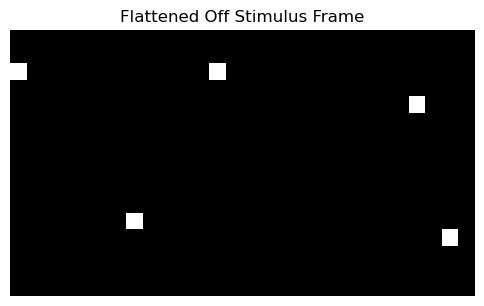

In [90]:
# Plot a single flattened stimulus frame
import matplotlib.pyplot as plt
plt.figure(figsize=(6, 6))
plt.imshow(flattened_off_stimuli[:,0].reshape(stim_h, stim_w), cmap='gray')
plt.title('Flattened Off Stimulus Frame')
plt.axis('off')
plt.show()

In [ ]:
import importlib
importlib.reload(U)  # Reload utils to ensure you're using the latest version of your functions
lags_to_test= np.array(list(range(10)))
selected_neurons = np.arange(binned_spikes.shape[0])  # Select all neurons for now 

all_rfs_spatiotemporal_on = U.fit_all_neurons_rfs_parallel(binned_spikes, flattened_on_stimuli, 
                                                   lags_to_test, selected_neurons=selected_neurons)


Step 3 & 4: Fitting spatio-temporal receptive fields in parallel using all cores...


Fitting neurons:  57%|█████▋    | 108/189 [32:29<28:36, 21.19s/it]

In [ ]:
#------ END LNP MODEL FITTING ------------------#

# Tuning Function with STA

# Tuning Function with Spline Basis in RFEST

In [67]:
use_cached_data = True


# --- Phase 3: Tuning Function Fitting ---
# Goal: Load the outputs from the previous notebooks (00 & 02) and use them 
# to estimate the receptive field (RF) for each neuron.

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import utils as U 
import importlib
import os
import glob

# Reload utils to ensure you're using the latest version of your functions
importlib.reload(U) 

if use_cached_data:
    try:
        # ACTION: Change 'aakarsh' to your namespace if needed.
        namespace = "aakarsh" 
        
        # --- Load the latest output from the preprocessing notebook (00-background.ipynb) ---
        background_dir = f'data/{namespace}/background/'
        list_of_background_files = glob.glob(os.path.join(background_dir, '*.npz'))
        if not list_of_background_files:
            raise FileNotFoundError(f"No background data files found in '{background_dir}'")
        
        latest_background_file = max(list_of_background_files, key=os.path.getctime)
        print(f"Loading latest background data from: {latest_background_file}")
        
        stim_data = np.load(latest_background_file, allow_pickle=True)
        stim_filtered = stim_data['stim_filtered']
        stim_table_filtered_df = pd.DataFrame(stim_data['stim_table_filtered'], columns=stim_data['stim_table_columns'])
        

        # --- Load the latest output from the spike inference notebook (02-spike-inference.ipynb) ---
        spike_inference_dir = f'data/{namespace}/preprocessed/'
        list_of_spike_files = glob.glob(os.path.join(spike_inference_dir, '*.npz'))
        if not list_of_spike_files:
            raise FileNotFoundError(f"No spike inference files found in '{spike_inference_dir}'")
        
        latest_spike_file = max(list_of_spike_files, key=os.path.getctime)
        print(f"Loading latest spike inference data from: {latest_spike_file}")
        
        spike_data = np.load(latest_spike_file, allow_pickle=True)
        print(spike_data.keys())

        inferred_spikes = spike_data['spike_counts']
        time_vector = spike_data['time_vector']
        sampling_rate = spike_data['sampling_frequency']
    
        data  = U.load_data()# Load the latest spike inference data
        data  = U.preprocess_data(data)  # Preprocess the data 

    except FileNotFoundError as e:
        print(f"ERROR: Could not find a necessary input file: {e}")
        print("Please ensure you have run the previous notebooks (00 and 02) and saved their outputs correctly.")
        raise

Loading latest background data from: data/aakarsh/background/cleaned_2025_07_16_17_35_52.npz
Loading latest spike inference data from: data/aakarsh/preprocessed/oasis_preprocessed_recordings_2025_07_18_10_16_01.npz
KeysView(NpzFile 'data/aakarsh/preprocessed/oasis_preprocessed_recordings_2025_07_18_10_16_01.npz' with keys: processed_neuron_signal, spike_counts, thresholds, sampling_frequency, time_vector)
Performing initial data preprocessing...
Preprocessing complete.


In [68]:
active_stim_per_timestep = U.get_active_stimulus_per_timestep(data['stim_table'], total_timesteps=len(data['t']))

Mapping active stimulus frame to each timestep...
Mapping complete.


In [69]:
importlib.reload(U)  # Reload utils to ensure you're using the latest version of your functions

# Prepare the stimulus matrix from the presented frame IDs
# Reload utils to ensure you're using the latest version of your functions

inferred_spikes = spike_data['spike_counts']
binned_spikes, presented_frame_ids =  inferred_spikes, active_stim_per_timestep # stimulus data is already binned. 

flattened_stim, stim_h, stim_w = \
    U.prepare_stimulus_matrix_from_ids(presented_frame_ids, full_stim_movie=data['stim'])

Preparing stimulus matrix from frame IDs...
Stimulus matrix preparation complete. Shape: (448, 105968)


In [70]:
# Convert the stimulus to binary matrices for 'ON' and 'OFF' stimuli, these are easier to train and give better receptive field estimates.

# Create a copy of the original flattened stimulus matrix
flattened_on_stimuli = flattened_stim.copy()
flattened_off_stimuli = flattened_stim.copy()

# For the 'ON' matrix, set all 'OFF' pixels (<= 127) to zero
flattened_on_stimuli[flattened_on_stimuli <= 127] = 0
flattened_on_stimuli[flattened_on_stimuli > 127] = 1

# For the 'OFF' matrix, set all 'ON' pixels (> 127) to zero
flattened_off_stimuli[flattened_off_stimuli < 127] = 1
flattened_off_stimuli[flattened_off_stimuli >= 127] = 0

# --- Verification ---
print(f"Flattened Stimulus Shape: {flattened_stim.shape}")
print(f"Flattened On Stimuli Shape: {flattened_on_stimuli.shape}")
print(f"Flattened Off Stimuli Shape: {flattened_off_stimuli.shape}")

# These assertions will now pass because the shape is preserved
assert flattened_on_stimuli.shape == flattened_stim.shape, "The shape of flattened_on_stimuli does not match the shape of flattened_stim."
assert flattened_off_stimuli.shape == flattened_stim.shape, "The shape of flattened_off_stimuli does not match the shape of flattened_stim."

print("\nAssertions passed! The shapes are now correct.")

Flattened Stimulus Shape: (448, 105968)
Flattened On Stimuli Shape: (448, 105968)
Flattened Off Stimuli Shape: (448, 105968)

Assertions passed! The shapes are now correct.


In [ ]:
# Plot a single flattened stimulus frame
import matplotlib.pyplot as plt
plt.figure(figsize=(6, 6))
plt.imshow(flattened_on_stimuli[:,0].reshape(stim_h, stim_w), cmap='gray')
plt.title('Flattened Stimulus Frame')
plt.axis('off')
plt.show()

In [ ]:
from rfest import splineLNP
from rfest import build_design_matrix


w_est_spline_coeffs = []
selected_neurons = range(binned_spikes.shape[0])  # Select all neurons for fitting
for neuron_idx in selected_neurons:
    neuron_to_fit = neuron_idx
    print(f"binned_spikes.shape: {binned_spikes.shape}")
    neuron_binned_spikes = binned_spikes[neuron_to_fit,: ]
    flattened_stim_for_rfest = flattened_on_stimuli.copy()
    print(f"flattened_stim_for_rfest.shape: {flattened_stim_for_rfest.shape}")
    num_lags = 10  # Number of lags to consider for the GLM
    dims = (num_lags, stim_h, stim_w)
    print(f"dims: {dims}")
    df = (8, 8, 12) # (time, height, width)


    X_design = build_design_matrix(flattened_stim_for_rfest.T, nlag=num_lags)
    # Remove the first num_lags-1 entries from the binned spikes to match the response length
    y_response = np.array(neuron_binned_spikes)
    y_response = y_response.astype(np.float64)

    print(f"X_design.shape: {X_design.shape}")

    print(f"X_design.shape: {X_design.shape}")
    print(f"y_response.shape: {y_response.shape}")
    model = splineLNP(X_design, y_response, dims=dims, df=df)
    print(f"Model initialized for Neuron {neuron_to_fit} with dims: {dims} and df: {df}")
    # Fit the model. This performs the optimization.
    print(f"Fitting splineLNP model for Neuron {neuron_to_fit}...")
    model.fit(beta=0.01, num_iters=200, verbose=10)

    # The estimated receptive field is stored in model.w_opt
    w_est_spline = model.w_opt
    w_est_spline_coeffs.append(w_est_spline)
    print(f"\n Neuron {neuron_to_fit} Fitting complete!")

# Statistical Testing and Spatial Analysis

In [2]:
use_cached_data = True

In [20]:
import glob
import os
import numpy as np
import pandas as pd
import utils 
import utils as U
import  importlib

importlib.reload(utils)
importlib.reload(U)


if use_cached_data:
    try:
        namespace = "aakarsh" 
        
        background_dir = f'data/{namespace}/receptive_fields_spline/'
        list_of_background_files = glob.glob(os.path.join(background_dir, '*.npz'))
        list_of_background_files = [f for f in list_of_background_files if 'w_est_spline_coeffs' in f]
        print(f"Found files in '{background_dir}': {list_of_background_files}")
        
        if not list_of_background_files:
            raise FileNotFoundError(f"No background data files found in '{background_dir}'")

        print(f"Found {len(list_of_background_files)} background data files in '{background_dir}'") 
        latest_coefficients_file = max(list_of_background_files, key=os.path.getctime)
        print(f"Loading latest background data from: {latest_coefficients_file}")
        loaded_data = np.load(latest_coefficients_file, allow_pickle=True)
        w_est_spline_coeffs = loaded_data['w_est_spline_coeffs']
        dims = loaded_data['dims']
        num_lags, stim_h, stim_w = dims
            # Load the original raw data to get ROI masks and max projection
        data = U.load_data() # Assuming the load_data function is in utils.py or defined
        roi_masks = data['roi_masks']
        max_projection_image = data['max_projection']
        
        print(f"w_est_spline_coeffs loaded with shape: {w_est_spline_coeffs.shape if hasattr(w_est_spline_coeffs, 'shape') else 'N/A'}")
        print(f"Loaded data keys: {loaded_data.keys()}")
    except Exception as e:
        print(f"Error loading background data: {e}")
        raise 

Found files in 'data/aakarsh/receptive_fields_spline/': ['data/aakarsh/receptive_fields_spline/w_est_spline_coeffs_2025_07_19_18_39_26.npz', 'data/aakarsh/receptive_fields_spline/w_est_spline_coeffs_2025_07_19_13_43_25.npz']
Found 2 background data files in 'data/aakarsh/receptive_fields_spline/'
Loading latest background data from: data/aakarsh/receptive_fields_spline/w_est_spline_coeffs_2025_07_19_18_39_26.npz
w_est_spline_coeffs loaded with shape: (189, 4480)
Loaded data keys: KeysView(NpzFile 'data/aakarsh/receptive_fields_spline/w_est_spline_coeffs_2025_07_19_18_39_26.npz' with keys: w_est_spline_coeffs, binned_spikes, flattened_off_stimuli, flattened_on_stimuli, stim_h...)


In [50]:
import matplotlib.pyplot as plt
import numpy as np
## 1. Get the dimensions for the plot grid
num_neurons = w_est_spline_coeffs.shape[0]
num_lags, stim_h, stim_w = dims
selected_neurons = range(num_neurons)

# 2. Create a single figure with a grid of subplots
# The grid will have 'num_neurons' rows and 'num_lags' columns.
fig, axes = plt.subplots(
    num_neurons,
    num_lags,
    figsize=(num_lags * 2, num_neurons * 2.2),
    squeeze=False  # Always return a 2D array for axes
)

fig.suptitle("Spatio-Temporal Receptive Fields (All Neurons)", fontsize=16)

# 3. Loop through each neuron and its corresponding row of axes
for neuron_idx, w_flat in enumerate(w_est_spline_coeffs):
    neuron_id = selected_neurons[neuron_idx]
    
    # Reshape the flattened weights to (time, height, width)
    strf = w_flat.reshape(dims)
    
    # Normalize color scale per-neuron for fair comparison across its own lags
    vmin, vmax = strf.min(), strf.max()
    
    # Set the y-label for the row to identify the neuron
    axes[neuron_idx, 0].set_ylabel(
        f"Neuron {neuron_id}",
        rotation=0,
        size='large',
        labelpad=40, # Move label to the left
        ha='right',
        va='center'
    )
    
    # Loop through each time lag and its column
    for lag_idx in range(num_lags):
        ax = axes[neuron_idx, lag_idx]
        
        # Plot the spatial receptive field at this lag
        ax.imshow(strf[lag_idx], cmap='bwr', vmin=vmin, vmax=vmax)
        ax.axis('off') # Hide axis ticks and borders

        # --- CHANGE ---
        # Set a title for every subplot to show its corresponding lag.
        # The 'if' condition that restricted this to the first row is removed.
        ax.set_title(f"Neuron {neuron_id} Lag {lag_idx} ")

# 4. Adjust layout and display the single plot
plt.tight_layout(rect=[0, 0, 1, 0.96]) # Adjust rect to make space for suptitle
plt.show()

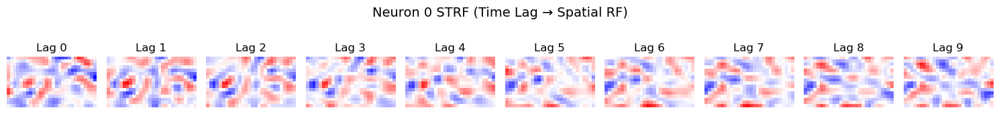

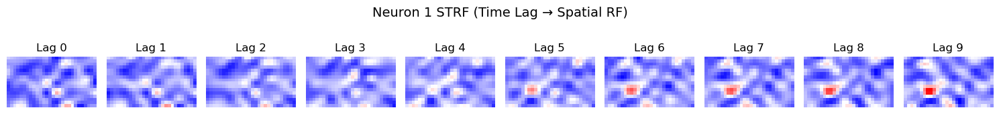

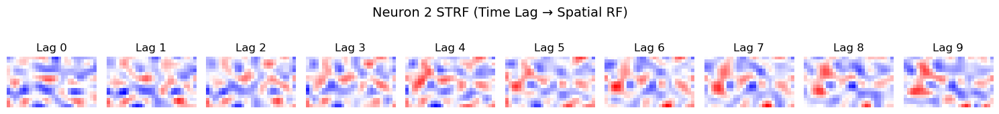

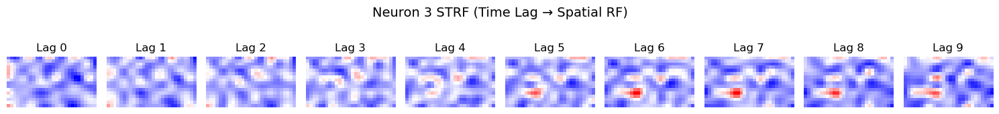

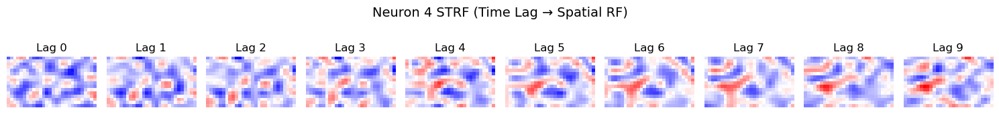

...

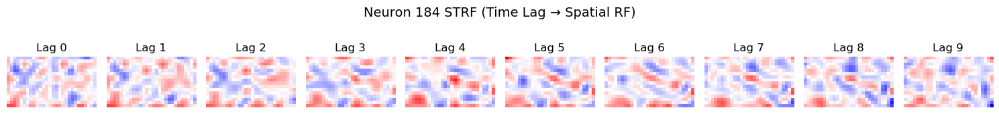

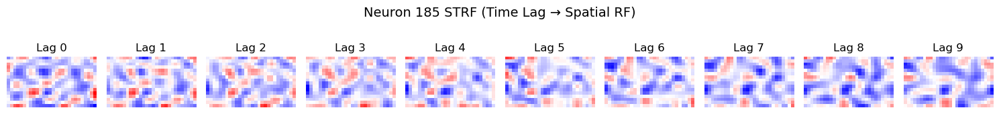

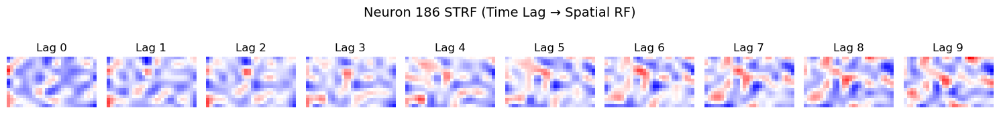

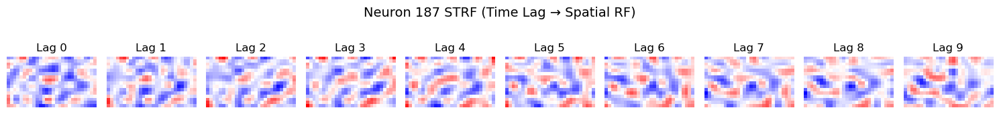

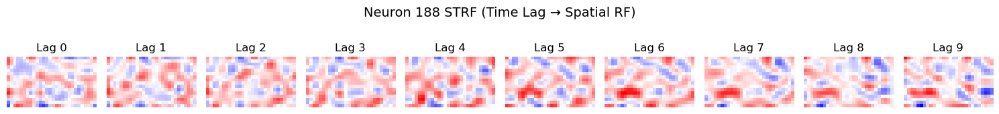

In [42]:
import matplotlib.pyplot as plt
import numpy as np

# Reuse dims and selected_neurons
num_lags, stim_h, stim_w = dims
selected_neurons = range(w_est_spline_coeffs.shape[0])  # Assuming all neurons are selected
for idx, w_flat in enumerate(w_est_spline_coeffs):
    neuron_idx = selected_neurons[idx]
    
    # Reshape to (time lags, height, width)
    strf = w_flat.reshape(dims)
    
    # Plot all lags
    fig, axes = plt.subplots(1, num_lags, figsize=(num_lags * 1.5, 2))
    fig.suptitle(f"Neuron {neuron_idx} STRF (Time Lag → Spatial RF)", fontsize=14)

    # Normalize color scale across all lags for fair comparison
    vmin, vmax = strf.min(), strf.max()
    for t in range(num_lags):
        ax = axes[t]
        ax.imshow(strf[t], cmap='bwr', vmin=vmin, vmax=vmax)
        ax.set_title(f"Lag {t}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()

### Localized Receptive Fields

In [21]:
import utils
importlib.reload(utils)
from scipy.linalg import svd


def extract_spatial_rf(w_est_spline_coeffs, dims, selected_neurons=None):
    """
    Extract spatial receptive fields from spline coefficients.
    
    Args:
        w_est_spline_coeffs: Coefficients of the spline fit.
        dims: Dimensions of the receptive field (num_lags, height, width).
        selected_neurons: List of neuron indices to visualize.
    
    Returns:
        List of spatial receptive fields for each selected neuron.
    """
    if selected_neurons is None:
        selected_neurons = range(w_est_spline_coeffs.shape[0])
    spatial_rf_list = []
    for neuron_idx in selected_neurons:
        neuron_west_spline = w_est_spline_coeffs[neuron_idx]
        # Reshape the flattened w_est back into its spatio-temporal form
        strf_spline = neuron_west_spline.reshape(dims)  # (20, 16, 28)

        num_pixels = stim_h * stim_w
        strf_for_vis = strf_spline.transpose(1, 2, 0).reshape(num_pixels, num_lags)

        # Perform SVD to get the separated components
        w_centered = strf_for_vis - strf_for_vis.mean(axis=1, keepdims=True)
        U, _, Vt = svd(w_centered, full_matrices=False)

        spatial_rf = U[:, 0].reshape(stim_h, stim_w)
        temporal_rf = Vt[0, :]

        # Sign correction for consistent plotting
        if np.abs(np.min(spatial_rf)) > np.abs(np.max(spatial_rf)):
            spatial_rf *= -1
            temporal_rf *= -1
            
        spatial_rf_list.append(spatial_rf)
        
    return np.array(spatial_rf_list)

spatial_rfs = extract_spatial_rf(w_est_spline_coeffs, dims)
gaussian_fits_statistics_df = utils.quantify_all_rfs(spatial_rfs) 

Quantifying localization for all spatial RFs...


/Users/aakarsh/src/TUE-SUMMER-2025/nds-final-project-summer25/utils.py:1438: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(gaussian_2d, (x, y), rf_map.ravel(), p0=initial_guess)


Quantification complete.


In [22]:
gaussian_fits_statistics_df

,neuron_id,r_squared,rf_size,amplitude,rf_center_x,rf_center_y
0,32,7.980294e-01,1.254756,0.409102,4.104507,10.960805
1,112,7.762630e-01,1.275289,0.396093,5.858431,10.805198
2,120,7.630063e-01,1.340931,0.373918,6.141740,10.673456
3,87,7.436450e-01,1.327739,0.373745,3.712810,11.530277
4,182,7.212877e-01,1.159580,0.416098,5.578175,10.829691
...,...,...,...,...,...,...
184,94,0.000000e+00,NaN,0.000000,NaN,NaN
185,70,-2.220446e-16,0.047945,0.048159,27.614599,3.312984
186,157,-2.220446e-16,7.559021,0.043828,-43.471909,-20.006703
187,106,-2.220446e-16,2.309888,0.010537,42.738200,6.513155


### Distribution of Gaussian Fits of Receptive Fieldss

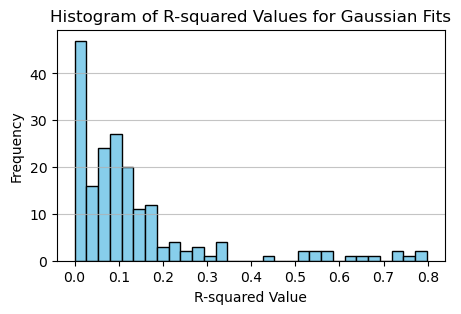

In [23]:
import matplotlib.pyplot as plt

# Plot histogram of R-squared values
plt.figure(figsize=(5, 3))
plt.hist(gaussian_fits_statistics_df['r_squared'], bins=30, color='skyblue', edgecolor='black')
plt.title('Histogram of R-squared Values for Gaussian Fits')
plt.xlabel('R-squared Value')
plt.ylabel('Frequency')
plt.grid(axis='y', alpha=0.75)
plt.show()

## Filter neurons with R-squared > 0.5


In [24]:
high_r_squared_neurons = gaussian_fits_statistics_df[gaussian_fits_statistics_df['r_squared'] > 0.5]

In [25]:
high_r_squared_neurons

,neuron_id,r_squared,rf_size,amplitude,rf_center_x,rf_center_y
0,32,0.798029,1.254756,0.409102,4.104507,10.960805
1,112,0.776263,1.275289,0.396093,5.858431,10.805198
2,120,0.763006,1.340931,0.373918,6.141740,10.673456
3,87,0.743645,1.327739,0.373745,3.712810,11.530277
4,182,0.721288,1.159580,0.416098,5.578175,10.829691
5,179,0.668516,3.020953,0.166681,6.322223,12.618535
6,43,0.643597,1.446244,0.310654,4.676575,12.050324
7,50,0.623774,1.100576,0.411854,4.590362,10.963093
8,111,0.568624,1.243492,0.348849,4.440787,10.892501
9,24,0.562344,1.123212,0.382697,5.546003,10.803204


#### Visualize Simple Receptive Fields

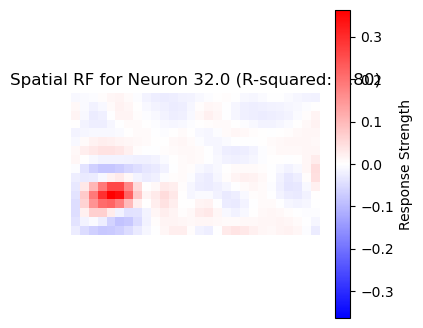

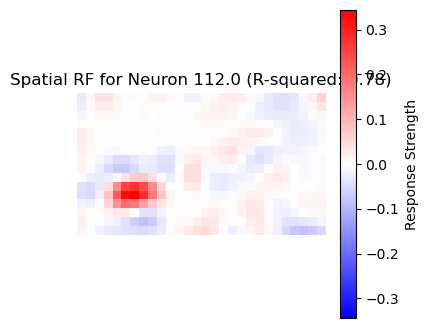

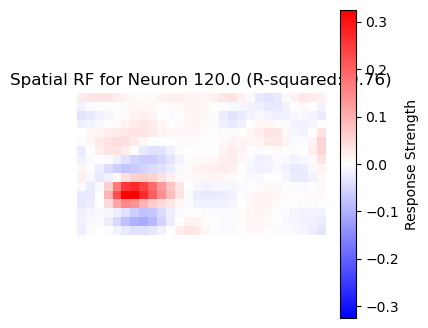

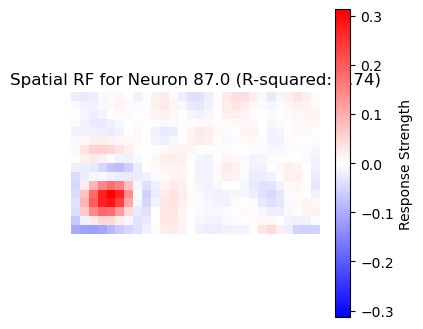

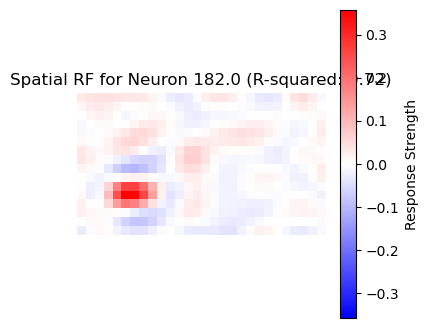

...

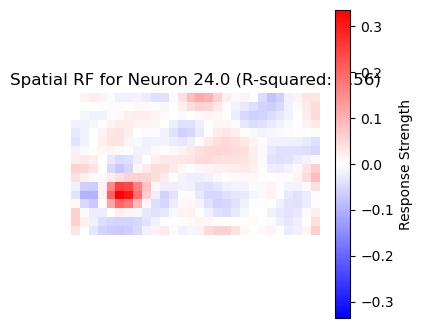

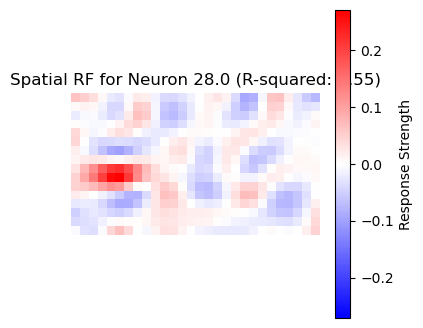

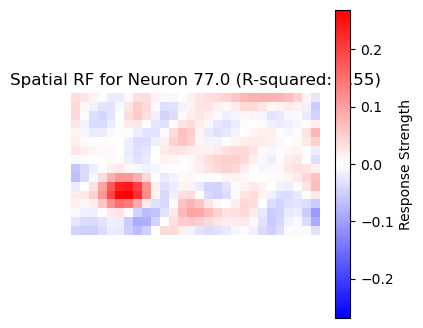

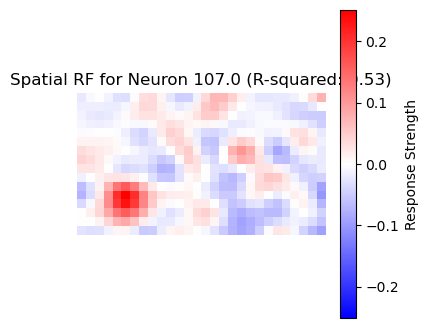

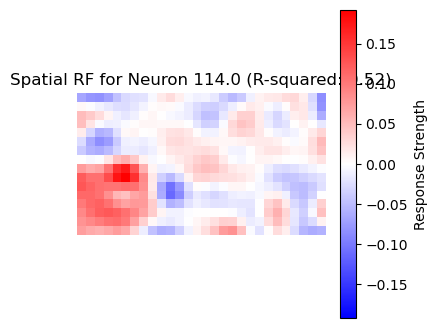

In [26]:
spatial_rfs = extract_spatial_rf(w_est_spline_coeffs, dims, selected_neurons=high_r_squared_neurons['neuron_id'].tolist())
for idx, row in high_r_squared_neurons.iterrows():
    spatial_rf = spatial_rfs[idx]
    plt.figure(figsize=(4, 4))
    plt.imshow(spatial_rf, cmap='bwr', vmin=-np.max(np.abs(spatial_rf)), vmax=np.max(np.abs(spatial_rf)))
    plt.title(f"Spatial RF for Neuron {row['neuron_id']} (R-squared: {row['r_squared']:.2f})")
    plt.colorbar(label='Response Strength')
    plt.axis('off')
    plt.show()

Calculating ROI centroid for neuron 32 (1/14)
Calculating centroids of ROI masks...
ROI centroid calculation complete.
Calculating ROI centroid for neuron 112 (2/14)
Calculating centroids of ROI masks...
ROI centroid calculation complete.
Calculating ROI centroid for neuron 120 (3/14)
Calculating centroids of ROI masks...
ROI centroid calculation complete.
Calculating ROI centroid for neuron 87 (4/14)
Calculating centroids of ROI masks...
ROI centroid calculation complete.
Calculating ROI centroid for neuron 182 (5/14)
Calculating centroids of ROI masks...
ROI centroid calculation complete.
Calculating ROI centroid for neuron 179 (6/14)
Calculating centroids of ROI masks...
ROI centroid calculation complete.
Calculating ROI centroid for neuron 43 (7/14)
Calculating centroids of ROI masks...
ROI centroid calculation complete.
Calculating ROI centroid for neuron 50 (8/14)
Calculating centroids of ROI masks...
ROI centroid calculation complete.
Calculating ROI centroid for neuron 111 (9/1

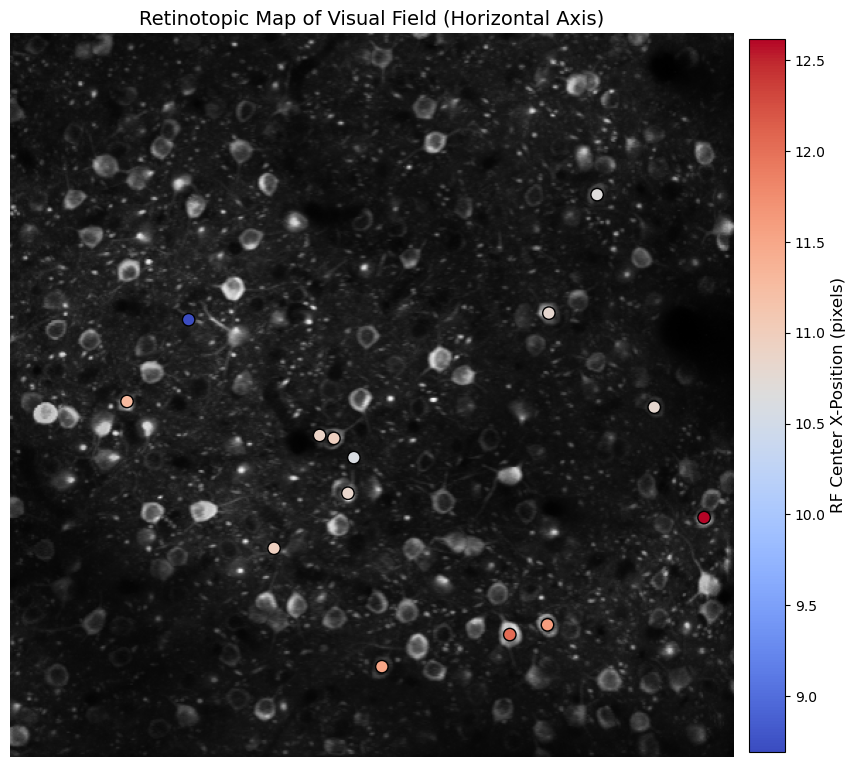

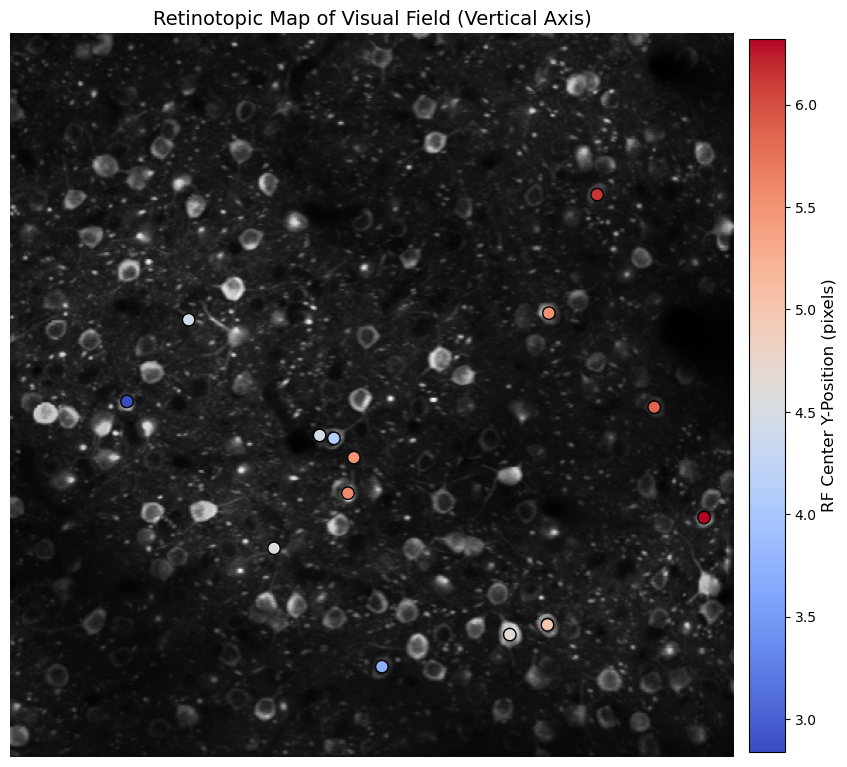

In [27]:
# Calculate the physical (x, y) coordinates for each neuron from its ROI mask
neuron_idxs = high_r_squared_neurons['neuron_id'].tolist() if 'neuron_id' in high_r_squared_neurons.columns else None
roi_centroids = []
for idx, neuron_idx in enumerate(neuron_idxs):
    print(f"Calculating ROI centroid for neuron {neuron_idx} ({idx+1}/{len(neuron_idxs)})") 
    roi_mask_selection = np.array([roi_masks[neuron_idx]])
    roi_centroids.append(U.calculate_roi_centroids(roi_mask_selection))
roi_centroids = np.array(roi_centroids)
roi_centroids = roi_centroids.reshape(-1, 2)  # Ensure shape is (N, 2) for (x, y) coordinates
print(f"All ROI centroids: {roi_centroids.shape}")

# Calculate the functional (x, y) coordinates for each RF from the spatial maps
rf_centers = np.array(list(zip(high_r_squared_neurons['rf_center_x'].values , high_r_squared_neurons['rf_center_y'].values)))
print(f"RF centers shape: {rf_centers.shape if rf_centers is not None else 'N/A'}")
#U.calculate_rf_centers(all_rfs_spatial)


# --- Step 3: Visualize the Retinotopic Map ---
# This is the key visualization that tests the project's hypothesis.
# We create two plots to map the horizontal (X) and vertical (Y) axes.

print("\nGenerating retinotopic maps...")

# Plot 1: Map of the horizontal (X) axis of the visual field
U.plot_retinotopic_map(
    roi_centroids=roi_centroids,
    rf_centers=rf_centers,
    background_image=max_projection_image,
    axis_to_map='x'
)

# Plot 2: Map of the vertical (Y) axis of the visual field
U.plot_retinotopic_map(
    roi_centroids=roi_centroids,
    rf_centers=rf_centers,
    background_image=max_projection_image,
    axis_to_map='y'
)